In [99]:
import os
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import math
import re
import statsmodels.api as sm
import folium

matplotlib.rcParams['xtick.labelsize']=20
matplotlib.rcParams['ytick.labelsize']=20


# Seattle data
Let's import and investigate the Seattle data and see if we can use any of it and what modifications would be necessary. 

In [100]:
#Import Listings
df_seattle_list = pd.read_csv('input/seattle/listings.csv')
print(df_seattle_list.shape)
df_seattle_list.head(5)

(3818, 92)


,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,notes,transit,thumbnail_url,medium_url,picture_url,xl_picture_url,host_id,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_listings_count,host_total_listings_count,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,market,smart_location,country_code,country,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,calendar_updated,has_availability,availability_30,availability_60,availability_90,availability_365,calendar_last_scraped,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,requires_license,license,jurisdiction_names,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,241032,https://www.airbnb.com/rooms/241032,20160104002432,2016-01-04,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,none,NaN,NaN,NaN,NaN,NaN,https://a1.muscache.com/ac/pictures/67560560/c...,NaN,956883,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.636289,-122.371025,t,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",NaN,$85.00,NaN,NaN,NaN,NaN,2,$5.00,1,365,4 weeks ago,t,14,41,71,346,2016-01-04,207,2011-11-01,2016-01-02,95.0,10.0,10.0,10.0,10.0,9.0,10.0,f,NaN,WASHINGTON,f,moderate,f,f,2,4.07
1,953595,https://www.airbnb.com/rooms/953595,20160104002432,2016-01-04,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,none,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/im/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,https://a0.muscache.com/ac/pictures/14409893/f...,5177328,https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,Seattle,"Seattle, WA",US,United States,47.639123,-122.365666,t,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",NaN,$150.00,"$1,000.00","$3,000.00",$100.00,$40.00,1,$0.00,2,90,today,t,13,13,16,291,2016-01-04,43,2013-08-19,2015-12-29,96.0,10.0,10.0,10.0,10.0,10.0,10.0,f,NaN,WASHINGTON,f,strict,t,t,6,1.48
2,3308979,https://www.airbnb.com/rooms/3308979,20160104002432,2016-01-04,New Modern House-Amazi

In [101]:
#Import calendar.csv
df_seattle_cal = pd.read_csv('input/seattle/calendar.csv', parse_dates=[1])
print(df_seattle_cal.shape)
df_seattle_cal.head(5)

(1393570, 4)


,listing_id,date,available,price
0,241032,2016-01-04,t,$85.00
1,241032,2016-01-05,t,$85.00
2,241032,2016-01-06,f,NaN
3,241032,2016-01-07,f,NaN
4,241032,2016-01-08,f,NaN


In [102]:
#import reviews 
df_seattle_rev = pd.read_csv('input/seattle/reviews.csv', parse_dates=[2])
print(df_seattle_rev.shape)
df_seattle_rev.head(5)

(84849, 6)


,listing_id,id,date,reviewer_id,reviewer_name,comments
0,7202016,38917982,2015-07-19,28943674,Bianca,Cute and cozy place. Perfect location to every...
1,7202016,39087409,2015-07-20,32440555,Frank,Kelly has a great room in a very central locat...
2,7202016,39820030,2015-07-26,37722850,Ian,"Very spacious apartment, and in a great neighb..."
3,7202016,40813543,2015-08-02,33671805,George,Close to Seattle Center and all it has to offe...
4,7202016,41986501,2015-08-10,34959538,Ming,Kelly was a great host and very accommodating ...


Lets dive into the listings dataframe in more detail to understand what is actually there. It seems the calendar and reviews dataframe are useful as metadata if we want to dig deep into the matter, but we will wait a bit with this now.

## Listings 

First thing we need to understand more of what data are available in the columns in the listings. Some of the data can probably be discarded right away, or kept in the background until we need more nuanced insights, while other columns should be our main pillars of knowledge.

Let's first see if some columns are practically without information

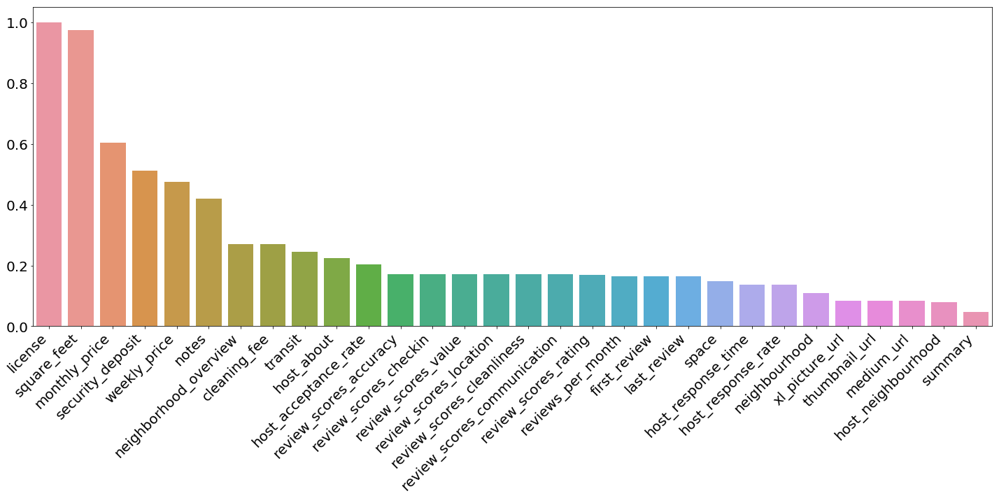

In [103]:
missing_list = (1-df_seattle_list.count()/df_seattle_list.shape[0]).sort_values(ascending=False)
fig, ax = plt.subplots(figsize=(20,10))
sns.barplot(x=missing_list[missing_list>0.01].index, y = missing_list[missing_list>0.01] , ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right');
plt.tight_layout()
#ax.set_ylabel('Missing values ratio', size=15)

First of all we can see from this that the license are missing for all. When looking closer at the columns, there is a column called "requires_license". This seems to be all false, hence there is little information about the license and we can add both of those to a list of columns to drop for Seattle. However, that does not mean it can be dropped for other cities.

Anyway, any column that have one unique value will not provide any additional information about the host or client or anything else, it is equal for all our datapoints. So we will first find all those columns and see how many and what they are, and ditch them. 

In [104]:
pd.set_option('display.max_rows', 1000)
(df_seattle_list.count()/df_seattle_list.shape[0]).sort_values()

license                             0.000000
square_feet                         0.025406
monthly_price                       0.397328
security_deposit                    0.488738
weekly_price                        0.526192
notes                               0.579361
neighborhood_overview               0.729701
cleaning_fee                        0.730225
transit                             0.755369
host_about                          0.775013
host_acceptance_rate                0.797538
review_scores_checkin               0.827658
review_scores_accuracy              0.827658
review_scores_value                 0.828182
review_scores_location              0.828444
review_scores_cleanliness           0.828968
review_scores_communication         0.829492
review_scores_rating                0.830540
last_review                         0.835778
first_review                        0.835778
reviews_per_month                   0.835778
space                               0.850969
host_respo

Text(0, 0.5, 'Number of unique entries')

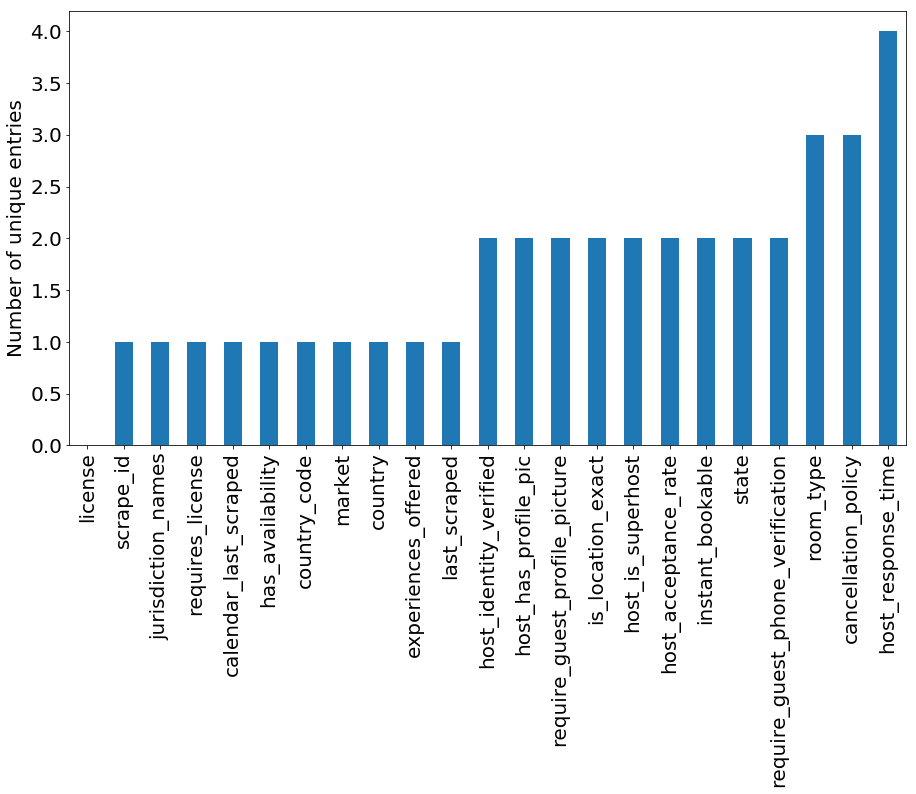

In [105]:
ax = df_seattle_list.nunique()[df_seattle_list.nunique()<5].sort_values().plot(kind='bar', figsize=(15,8))
ax.set_ylabel('Number of unique entries', fontsize=20)

Lets remove the uninformative columns right away

In [106]:
df_seattle_list_reduced = df_seattle_list.drop(labels=df_seattle_list.nunique()[df_seattle_list.nunique()<2].index, axis=1)
df_seattle_list_reduced.shape

(3818, 81)

Lets also look at the other end of the scale, the columns that has basically all unique values. No overlapping ones. 

Text(0, 0.5, 'Unique ratio')

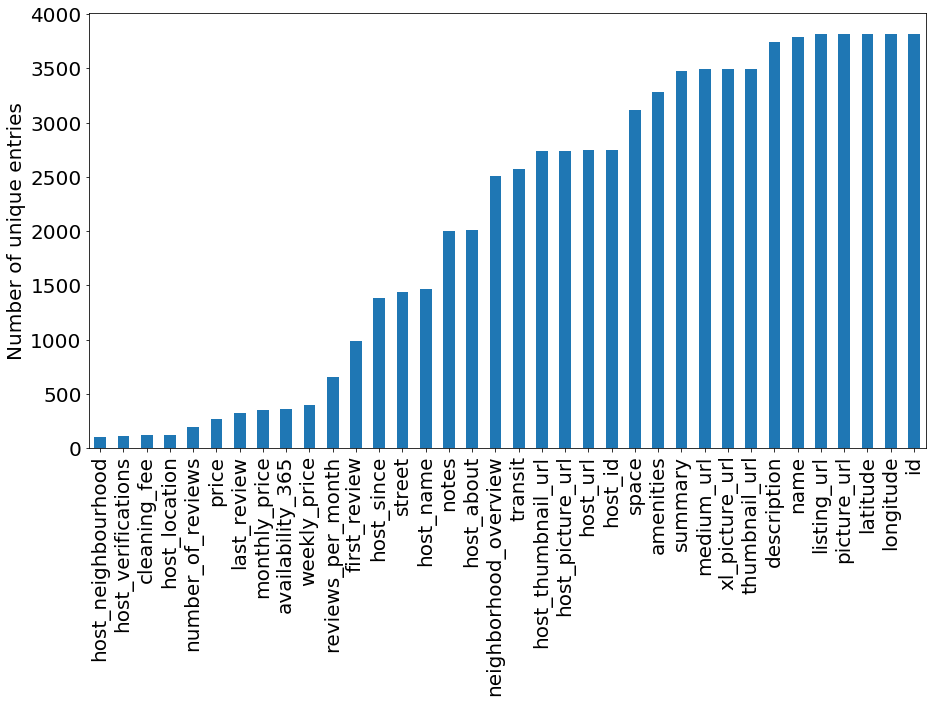

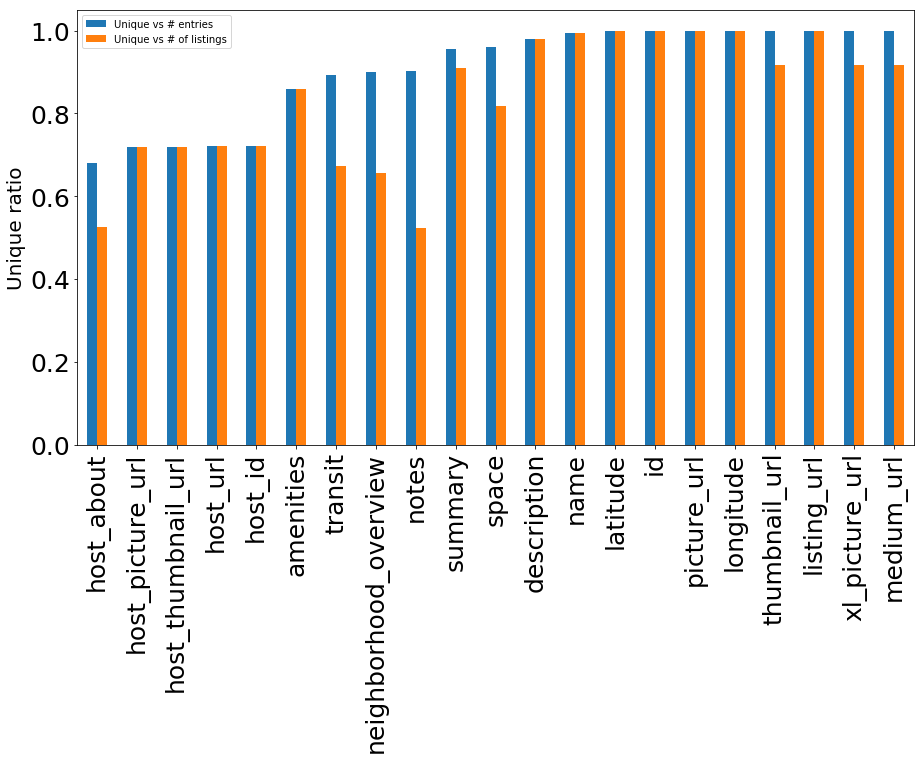

In [107]:
ax = (df_seattle_list.nunique())[df_seattle_list.nunique()>100].sort_values().plot(kind='bar', figsize=(15,8))
#(df_seattle_list.nunique()/df_seattle_list.shape[0])[df_seattle_list.nunique()>100].sort_values().plot(kind='bar', figsize=(15,8), ax=ax)
ax.set_ylabel('Number of unique entries', fontsize=20)
df_unique_ratios = pd.DataFrame({'Unique vs # entries': df_seattle_list.nunique()/df_seattle_list.count(), 'Unique vs # of listings': df_seattle_list.nunique()/df_seattle_list.shape[0]})
ax2 = df_unique_ratios[df_unique_ratios['Unique vs # entries']>0.5].sort_values('Unique vs # entries').plot(kind='bar', figsize=(15,8), fontsize=25)
ax2.set_ylabel('Unique ratio', fontsize=20)

We can see that the ratio of unique values change slightly if we related it to actual number of entries. 

We can see that there are quite some columns that would not give any useful information as they are all different.

Latitude and Longitude are also among the columns with all unique values. These are expected to be unique and still give insight, thus these cannot be removed. However, it will not matter much what url people use for their pics, unless, maybe, there is a difference if they have pictures or not... Again, we can see that all has a picture url (further up), and all is unique, so not much to gain from this. 

We can also see that less than 80% of number of listings with a host (probably every listing) have a unique host. The rest of the listings are then hosted by the same person having more than one listing. 



To ease our pain, we will remove the columns with all unique values (except for latitude and longitude, also id can be useful if we want to use the calendar and review data).

In [108]:
all_unique_cols = df_unique_ratios[df_unique_ratios['Unique vs # entries']==1]
all_unique_cols = all_unique_cols.drop(labels=['latitude', 'longitude', 'id'], axis=0).index
all_unique_cols
df_seattle_list_reduced = df_seattle_list_reduced.drop(labels=all_unique_cols, axis=1)
df_seattle_list_reduced.shape

(3818, 76)

As seen above, there are still 75 columns after removing columns without information and we need to go deeper into some of them to see what they are. Lets first check quickly what the different columns type is. 

In [109]:
df_seattle_list_reduced.get_dtype_counts()

int64      12
object     48
float64    16
dtype: int64

We can see that 16 of them are floats, while 12 is integers. Floats are usually numerical continous values, but could also be ordinal or categorical if not formatted properly. Integers are probably both categorical and ordinal values, but we will look further into the different ones. The object group is here a mix of text boxes and categorical values. As we saw from the number of unique entries above, there are several columns that has a limited number of entries, and thus is a categorical or ordinal value and not free text, or free numbers. 

First, a look at the floats

In [110]:
df_list_float = df_seattle_list_reduced.select_dtypes(include='float')
df_list_float.head(5)

,host_listings_count,host_total_listings_count,latitude,longitude,bathrooms,bedrooms,beds,square_feet,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
0,3.0,3.0,47.636289,-122.371025,1.0,1.0,1.0,NaN,95.0,10.0,10.0,10.0,10.0,9.0,10.0,4.07
1,6.0,6.0,47.639123,-122.365666,1.0,1.0,1.0,NaN,96.0,10.0,10.0,10.0,10.0,10.0,10.0,1.48
2,2.0,2.0,47.629724,-122.369483,4.5,5.0,7.0,NaN,97.0,10.0,10.0,10.0,10.0,10.0,10.0,1.15
3,1.0,1.0,47.638473,-122.369279,1.0,0.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2.0,2.0,47.632918,-122.372471,2.0,3.0,3.0,NaN,92.0,9.0,9.0,10.0,10.0,9.0,9.0,0.89


In [111]:
print(df_list_float.shape)
df_list_float.describe()

(3818, 16)


,host_listings_count,host_total_listings_count,latitude,longitude,bathrooms,bedrooms,beds,square_feet,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,reviews_per_month
count,3816.000000,3816.000000,3818.000000,3818.000000,3802.000000,3812.000000,3817.000000,97.000000,3171.000000,3160.000000,3165.000000,3160.000000,3167.000000,3163.000000,3162.000000,3191.000000
mean,7.157757,7.157757,47.628961,-122.333103,1.259469,1.307712,1.735394,854.618557,94.539262,9.636392,9.556398,9.786709,9.809599,9.608916,9.452245,2.078919
std,28.628149,28.628149,0.043052,0.031745,0.590369,0.883395,1.139480,671.404893,6.606083,0.698031,0.797274,0.595499,0.568211,0.629053,0.750259,1.822348
min,1.000000,1.000000,47.505088,-122.417219,0.000000,0.000000,1.000000,0.000000,20.000000,2.000000,3.000000,2.000000,2.000000,4.000000,2.000000,0.020000
25%,1.000000,1.000000,47.609418,-122.354320,1.000000,1.000000,1.000000,420.000000,93.000000,9.000000,9.000000,10.000000,10.000000,9.000000,9.000000,0.695000
50%,1.000000,1.000000,47.623601,-122.328874,1.000000,1.000000,1.000000,750.000000,96.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,1.540000
75%,3.000000,3.000000,47.662694,-122.310800,1.000000,2.000000,2.000000,1200.000000,99.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,3.000000
max,502.000000,502.000000,47.733358,-122.240607,8.000000,7.000000,15.000000,3000.000000,100.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,12.150000


The latitude and longitude is probably not that interesting given that we have the neighborhood. However, we saw above that quite some listings lacked the neighborhood and thus it could be interesting to use the position to estimate location. 

Also, the square feet, which could be interesting in general, seem to not be very easy to impute as most listings lack the data for it. 

Otherwise, we will keep the rest of the columns for now. 

Let's have a look at the integer columns

In [112]:
df_list_int = df_seattle_list_reduced.select_dtypes(include='integer')
df_list_int.head(5)

,id,host_id,accommodates,guests_included,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,calculated_host_listings_count
0,241032,956883,4,2,1,365,14,41,71,346,207,2
1,953595,5177328,4,1,2,90,13,13,16,291,43,6
2,3308979,16708587,11,10,4,30,1,6,17,220,20,2
3,7421966,9851441,3,1,1,1125,0,0,0,143,0,1
4,278830,1452570,6,6,1,1125,30,60,90,365,38,1


In [113]:
print(df_list_int.shape)
df_list_int.describe()

(3818, 12)


,id,host_id,accommodates,guests_included,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,calculated_host_listings_count
count,3.818000e+03,3.818000e+03,3818.000000,3818.000000,3818.000000,3818.000000,3818.000000,3818.000000,3818.000000,3818.000000,3818.000000,3818.000000
mean,5.550111e+06,1.578556e+07,3.349398,1.672603,2.369303,780.447617,16.786276,36.814825,58.082504,244.772656,22.223415,2.946307
std,2.962660e+06,1.458382e+07,1.977599,1.311040,16.305902,1683.589007,12.173637,23.337541,34.063845,126.772526,37.730892,5.893029
min,3.335000e+03,4.193000e+03,1.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,3.258256e+06,3.275204e+06,2.000000,1.000000,1.000000,60.000000,2.000000,13.000000,28.000000,124.000000,2.000000,1.000000
50%,6.118244e+06,1.055814e+07,3.000000,1.000000,2.000000,1125.000000,20.000000,46.000000,73.000000,308.000000,9.000000,1.000000
75%,8.035127e+06,2.590309e+07,4.000000,2.000000,2.000000,1125.000000,30.000000,59.000000,89.000000,360.000000,26.000000,2.000000
max,1.034016e+07,5.320861e+07,16.000000,15.000000,1000.000000,100000.000000,30.000000,60.000000,90.000000,365.000000,474.000000,37.000000


The integer columns seems to be all filled up and no big issues, there are no ordinal values hidden here. Hence, I will keep all the columns for now and start to look at the forest of object columns

In [114]:
df_list_obj = df_seattle_list_reduced.select_dtypes(include='object')
pd.options.display.max_columns = 500
df_list_obj.head(5)

,name,summary,space,description,neighborhood_overview,notes,transit,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,smart_location,is_location_exact,property_type,room_type,bed_type,amenities,price,weekly_price,monthly_price,security_deposit,cleaning_fee,extra_people,calendar_updated,first_review,last_review,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification
0,Stylish Queen Anne Apartment,NaN,Make your self at home in this charming one-be...,Make your self at home in this charming one-be...,NaN,NaN,NaN,https://www.airbnb.com/users/show/956883,Maija,2011-08-11,"Seattle, Washington, United States","I am an artist, interior designer, and run a s...",within a few hours,96%,100%,f,https://a0.muscache.com/ac/users/956883/profil...,https://a0.muscache.com/ac/users/956883/profil...,Queen Anne,"['email', 'phone', 'reviews', 'kba']",t,t,"Gilman Dr W, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,"Seattle, WA",t,Apartment,Entire home/apt,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",$85.00,NaN,NaN,NaN,NaN,$5.00,4 weeks ago,2011-11-01,2016-01-02,f,moderate,f,f
1,Bright & Airy Queen Anne Apartment,Chemically sensitive? We've removed the irrita...,"Beautiful, hypoallergenic apartment in an extr...",Chemically sensitive? We've removed the irrita...,"Queen Anne is a wonderful, truly functional vi...",What's up with the free pillows? Our home was...,"Convenient bus stops are just down the block, ...",https://www.airbnb.com/users/show/5177328,Andrea,2013-02-21,"Seattle, Washington, United States",Living east coast/left coast/overseas. Time i...,within an hour,98%,100%,t,https://a0.muscache.com/ac/users/5177328/profi...,https://a0.muscache.com/ac/users/5177328/profi...,Queen Anne,"['email', 'phone', 'facebook', 'linkedin', 're...",t,t,"7th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,"Seattle, WA",t,Apartment,Entire home/apt,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",$150.00,"$1,000.00","$3,000.00",$100.00,$40.00,$0.00,today,2013-08-19,2015-12-29,f,strict,t,t
2,New Modern House-Amazing water view,New modern house built in 2013. Spectacular s...,"Our house is modern, light and fresh with a wa...",New modern house built in 2013. Spectacular s...,Upper Queen Anne is a charming neighborhood fu...,Our house is located just 5 short blocks to To...,A bus stop is just 2 blocks away. Easy bus a...,https://www.airbnb.com/users/show/16708587,Jill,2014-06-12,"Seattle, Washington, United States",i love living in Seattle. i grew up in the mi...,within a few hours,67%,100%,f,https://a1.muscache.com/ac/users/16708587/prof...,https://a1.muscache.com/ac/users/16708587/prof...,Queen Anne,"['email', 'phone', 'google', 'reviews', 'jumio']",t,t,"West Lee Street, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,"Seattle, WA",t,House,Entire home/apt,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",$975.00,NaN,NaN,"$1,000.00",$300.00,$25.00,5 weeks ago,2014-07-30,2015-09-03,f,strict,f,f
3,Queen Anne Chateau,A charming apartment that sits atop Queen Anne...,NaN,A charming apartment that sits atop Queen Anne...,NaN,NaN,NaN,https://www.airbnb.com/users/show/9851441,Emily,2013-11-06,"Seattle, Washington, United States",NaN,NaN,NaN,NaN,f,https://a2.muscache.com/ac/users/9851441/profi...,https://a2.muscache.com/ac/users/9851441/profi...,Queen Anne,"['email', 'phone', 'facebook', 'reviews', 'jum...",t,t,"8th Avenue West, Seattle, WA 98119, United States",Queen Anne,West Queen Anne,Queen Anne,Seattle,WA,98119,"Seattle, WA",t,Apartment,Entire home/

In [115]:
print(df_list_obj.shape)
df_list_obj.describe()

(3818, 48)


,name,summary,space,description,neighborhood_overview,notes,transit,host_url,host_name,host_since,host_location,host_about,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_thumbnail_url,host_picture_url,host_neighbourhood,host_verifications,host_has_profile_pic,host_identity_verified,street,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,city,state,zipcode,smart_location,is_location_exact,property_type,room_type,bed_type,amenities,price,weekly_price,monthly_price,security_deposit,cleaning_fee,extra_people,calendar_updated,first_review,last_review,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification
count,3818,3641,3249,3818,2786,2212,2884,3818,3816,3816,3810,2959,3295,3295,3045,3816,3816,3816,3518,3818,3816,3816,3818,3402,3818,3818,3818,3818,3811,3818,3818,3817,3818,3818,3818,3818,2009,1517,1866,2788,3818,3818,3191,3191,3818,3818,3818,3818
unique,3792,3478,3119,3742,2506,1999,2574,2751,1466,1380,120,2011,4,45,2,2,2743,2743,102,116,2,2,1442,81,87,17,7,2,28,7,2,16,3,5,3284,273,395,356,46,118,45,34,984,321,2,3,2,2
top,Capitol Hill Apartment,This is a modern fully-furnished studio apartm...,"*Note: This fall, there will be major renovati...",Our space is a mix of a hostel and a home. We ...,Wallingford is a mostly-residential neighborho...,All of our rentals are fully licensed and regu...,Convenient public transportation. The location...,https://www.airbnb.com/users/show/8534462,Andrew,2013-08-30,"Seattle, Washington, United States",It would be my pleasure to share and explore t...,within an hour,100%,100%,f,https://a2.muscache.com/ac/pictures/a4d7d053-c...,https://a2.muscache.com/ac/pictures/a4d7d053-c...,Capitol Hill,"['email', 'phone', 'facebook', 'reviews', 'kba']",t,t,"1st Avenue, Seattle, WA 98101, United States",Capitol Hill,Broadway,Other neighborhoods,Seattle,WA,98122,"Seattle, WA",t,House,Entire home/apt,Real Bed,{},$150.00,$500.00,"$2,500.00",$100.00,$50.00,$0.00,today,2015-09-21,2016-01-02,f,strict,f,f
freq,3,15,14,10,17,39,32,46,56,51,3259,46,1692,2371,3044,3038,46,46,405,595,3809,2997,30,351,397,794,3810,3817,420,3810,3412,1733,2541,3657,45,162,94,66,348,310,2048,706,25,94,3227,1417,3497,3443


Not all of these columns would be interesting in the first round of investigation, although quite some are. Firstly, I will drop free text fields which would need significant NLP efforts to extract wisdom from. The typical drop down menu columns will be converted to categorical or ordinal columns. 

In [116]:
drop_columns = ['name', 'summary', 'space', 'description', 'neighborhood_overview', 'notes', 'transit', 'host_url',
                'host_name', 'host_location', 'host_about','host_thumbnail_url', 'host_picture_url', 
                'host_neighbourhood', 'host_has_profile_pic', 'street','city','state','smart_location']

df_seattle_list_reduced = df_seattle_list_reduced.drop(drop_columns, axis=1)
df_seattle_list_reduced.shape

(3818, 57)

In [117]:
df_seattle_list_reduced

,id,host_id,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_verifications,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,zipcode,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,calendar_updated,availability_30,availability_60,availability_90,availability_365,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,241032,956883,2011-08-11,within a few hours,96%,100%,f,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",t,Queen Anne,West Queen Anne,Queen Anne,98119,47.636289,-122.371025,t,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",NaN,$85.00,NaN,NaN,NaN,NaN,2,$5.00,1,365,4 weeks ago,14,41,71,346,207,2011-11-01,2016-01-02,95.0,10.0,10.0,10.0,10.0,9.0,10.0,f,moderate,f,f,2,4.07
1,953595,5177328,2013-02-21,within an hour,98%,100%,t,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",t,Queen Anne,West Queen Anne,Queen Anne,98119,47.639123,-122.365666,t,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",NaN,$150.00,"$1,000.00","$3,000.00",$100.00,$40.00,1,$0.00,2,90,today,13,13,16,291,43,2013-08-19,2015-12-29,96.0,10.0,10.0,10.0,10.0,10.0,10.0,f,strict,t,t,6,1.48
2,3308979,16708587,2014-06-12,within a few hours,67%,100%,f,2.0,2.0,"['email', 'phone', 'google', 'reviews', 'jumio']",t,Queen Anne,West Queen Anne,Queen Anne,98119,47.629724,-122.369483,t,House,Entire home/apt,11,4.5,5.0,7.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",NaN,$975.00,NaN,NaN,"$1,000.00",$300.00,10,$25.00,4,30,5 weeks ago,1,6,17,220,20,2014-07-30,2015-09-03,97.0,10.0,10.0,10.0,10.0,10.0,10.0,f,strict,f,f,2,1.15
3,7421966,9851441,2013-11-06,NaN,NaN,NaN,f,1.0,1.0,"['email', 'phone', 'facebook', 'reviews', 'jum...",t,Queen Anne,West Queen Anne,Queen Anne,98119,47.638473,-122.369279,t,Apartment,Entire home/apt,3,1.0,0.0,2.0,Real Bed,"{Internet,""Wireless Internet"",Kitchen,""Indoor ...",NaN,$100.00,$650.00,"$2,300.00",NaN,NaN,1,$0.00,1,1125,6 months ago,0,0,0,143,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f,flexible,f,f,1,NaN
4,278830,1452570,2011-11-29,within an hour,100%,NaN,f,2.0,2.0,"['email', 'phone', 'facebook', 'reviews', 'kba']",t,Queen Anne,West Queen Anne,Queen Anne,98119,47.632918,-122.372471,t,House,Entire home/apt,6,2.0,3.0,3.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",NaN,$450.00,NaN,NaN,$700.00,$125.00,6,$15.00,1,1125,7 weeks ago,30,60,90,365,38,2012-07-10,2015-10-24,92.0,9.0,9.0,10.0,10.0,9.0,9.0,f,strict,f,f,1,0.89
5,5956968,326758,2010-12-25,NaN,NaN,NaN,f,1.0,1.0,"['email', 'phone', 'facebook', 'reviews', 'kba']",t,Queen Anne,West Queen Anne,Queen Anne,98119,47.630525,-122.366174,t,House,Private room,2,1.0,1.0,1.0,Real Bed,"{""Wireless Internet"",""Free Parking on Premises...",NaN,$120.00,$800.00,NaN,NaN,$40.00,1,$30.00,1,6,2 weeks ago,0,0,27,302,17,2015-06-11,2015-09-28,95.0,10.0,10.0,10.0,10.0,10.0,10.0,f,strict,f,f,1,2.45
6,1909058,2497928,2012-05-30,within an hour,100%,100%,t,1.0,1.0,"['email', 'phone', 'reviews', 'kba']",t,Queen Anne,West Queen Anne,Queen Anne,98119,47.636605,-122.368519,t,House,Private room,2,1.0,1.0,1.0,Real Bed,"{""Wireless Internet"",""Free Parking on Premises...",NaN,$80.00,$575.00,NaN,$150.00,NaN,1,$10.00,3,14,5 weeks ago,20,49,71,346,58,2014-01-27,2015-12-07,99.0,10.0,10.0,10.0,10.0,10.0,10.0,f,moderate,f,f,1,2.46
7,856550,4016632,2012-10-

Lets start modifying the columns. As we see, there are formatting, missing numbers etc. some need more work than others. Lets start with the simpler ones. 

In [118]:
def currency_to_number(x):
    """Format dollar currency value with comma grouping to a float"""
    if isinstance(x, str):        
        if ',' in x:
            x = x.replace(',','')
        if '$' in x:
            x = x.strip('$')
        return float(x)
    elif math.isnan(x):
        return np.nan
    elif isinstance(x,float) and not math.isnan(x):
        return x
    else:
        raise TypeError
        
def percentage_to_ratio(x):
    """Format percentage string to float"""
    if isinstance(x, str):        
        if '%' in x:
            x = x.strip('%')
        return float(x)/100
    elif math.isnan(x):
        return np.nan
    elif isinstance(x,float) and not math.isnan(x):
        return x
    else:
        raise TypeError
        
def boolean_to_boolean(x):
    """Convert from f and t to Python False and True types"""
    
    if isinstance(x, str):        
        if x == 'f':
            return False
        elif x == 't':
            return True
        else:
            raise ValueError
    elif math.isnan(x):
        return np.nan
    elif isinstance(x,bool):
        return x
    else:
        print(x)
        raise TypeError
        
def boolean_to_int(x):
    """Convert from f and t to Python False and True types"""
    
    if isinstance(x, str):        
        if x == 'f':
            return 0
        elif x == 't':
            return 1
        else:
            raise ValueError
    elif math.isnan(x):
        return np.nan
    elif isinstance(x,bool):
        raise TypeError
    elif isinstance(x,int):
        return x
    else:
        print(x)
        raise TypeError
        

In [119]:
df_seattle_list_reduced['monthly_price'] = df_seattle_list_reduced['monthly_price'].map(currency_to_number);
df_seattle_list_reduced['price'] = df_seattle_list_reduced['price'].map(currency_to_number);
df_seattle_list_reduced['weekly_price'] = df_seattle_list_reduced['weekly_price'].map(currency_to_number);
df_seattle_list_reduced['security_deposit'] = df_seattle_list_reduced['security_deposit'].map(currency_to_number);
df_seattle_list_reduced['cleaning_fee'] = df_seattle_list_reduced['cleaning_fee'].map(currency_to_number);
df_seattle_list_reduced['extra_people'] = df_seattle_list_reduced['extra_people'].map(currency_to_number);

In [120]:
df_seattle_list_reduced['host_response_rate'] = df_seattle_list_reduced['host_response_rate'].map(percentage_to_ratio);
df_seattle_list_reduced['host_acceptance_rate'] = df_seattle_list_reduced['host_acceptance_rate'].map(percentage_to_ratio);

In [121]:
df_seattle_list_reduced['instant_bookable'] = df_seattle_list_reduced['instant_bookable'].map(boolean_to_boolean);
df_seattle_list_reduced['require_guest_profile_picture'] = df_seattle_list_reduced['require_guest_profile_picture'].map(boolean_to_boolean);
df_seattle_list_reduced['require_guest_phone_verification'] = df_seattle_list_reduced['require_guest_phone_verification'].map(boolean_to_boolean);
df_seattle_list_reduced['is_location_exact'] = df_seattle_list_reduced['is_location_exact'].map(boolean_to_boolean);
df_seattle_list_reduced['host_is_superhost'] = df_seattle_list_reduced['host_is_superhost'].map(boolean_to_int);
df_seattle_list_reduced['host_identity_verified'] = df_seattle_list_reduced['host_identity_verified'].map(boolean_to_boolean);

In [122]:
df_seattle_list_reduced

,id,host_id,host_since,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,host_verifications,host_identity_verified,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,zipcode,latitude,longitude,is_location_exact,property_type,room_type,accommodates,bathrooms,bedrooms,beds,bed_type,amenities,square_feet,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,calendar_updated,availability_30,availability_60,availability_90,availability_365,number_of_reviews,first_review,last_review,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month
0,241032,956883,2011-08-11,within a few hours,0.96,1.0,0.0,3.0,3.0,"['email', 'phone', 'reviews', 'kba']",True,Queen Anne,West Queen Anne,Queen Anne,98119,47.636289,-122.371025,True,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",NaN,85.0,NaN,NaN,NaN,NaN,2,5.0,1,365,4 weeks ago,14,41,71,346,207,2011-11-01,2016-01-02,95.0,10.0,10.0,10.0,10.0,9.0,10.0,False,moderate,False,False,2,4.07
1,953595,5177328,2013-02-21,within an hour,0.98,1.0,1.0,6.0,6.0,"['email', 'phone', 'facebook', 'linkedin', 're...",True,Queen Anne,West Queen Anne,Queen Anne,98119,47.639123,-122.365666,True,Apartment,Entire home/apt,4,1.0,1.0,1.0,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",NaN,150.0,1000.0,3000.0,100.0,40.0,1,0.0,2,90,today,13,13,16,291,43,2013-08-19,2015-12-29,96.0,10.0,10.0,10.0,10.0,10.0,10.0,False,strict,True,True,6,1.48
2,3308979,16708587,2014-06-12,within a few hours,0.67,1.0,0.0,2.0,2.0,"['email', 'phone', 'google', 'reviews', 'jumio']",True,Queen Anne,West Queen Anne,Queen Anne,98119,47.629724,-122.369483,True,House,Entire home/apt,11,4.5,5.0,7.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",NaN,975.0,NaN,NaN,1000.0,300.0,10,25.0,4,30,5 weeks ago,1,6,17,220,20,2014-07-30,2015-09-03,97.0,10.0,10.0,10.0,10.0,10.0,10.0,False,strict,False,False,2,1.15
3,7421966,9851441,2013-11-06,NaN,NaN,NaN,0.0,1.0,1.0,"['email', 'phone', 'facebook', 'reviews', 'jum...",True,Queen Anne,West Queen Anne,Queen Anne,98119,47.638473,-122.369279,True,Apartment,Entire home/apt,3,1.0,0.0,2.0,Real Bed,"{Internet,""Wireless Internet"",Kitchen,""Indoor ...",NaN,100.0,650.0,2300.0,NaN,NaN,1,0.0,1,1125,6 months ago,0,0,0,143,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,flexible,False,False,1,NaN
4,278830,1452570,2011-11-29,within an hour,1.00,NaN,0.0,2.0,2.0,"['email', 'phone', 'facebook', 'reviews', 'kba']",True,Queen Anne,West Queen Anne,Queen Anne,98119,47.632918,-122.372471,True,House,Entire home/apt,6,2.0,3.0,3.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",NaN,450.0,NaN,NaN,700.0,125.0,6,15.0,1,1125,7 weeks ago,30,60,90,365,38,2012-07-10,2015-10-24,92.0,9.0,9.0,10.0,10.0,9.0,9.0,False,strict,False,False,1,0.89
5,5956968,326758,2010-12-25,NaN,NaN,NaN,0.0,1.0,1.0,"['email', 'phone', 'facebook', 'reviews', 'kba']",True,Queen Anne,West Queen Anne,Queen Anne,98119,47.630525,-122.366174,True,House,Private room,2,1.0,1.0,1.0,Real Bed,"{""Wireless Internet"",""Free Parking on Premises...",NaN,120.0,800.0,NaN,NaN,40.0,1,30.0,1,6,2 weeks ago,0,0,27,302,17,2015-06-11,2015-09-28,95.0,10.0,10.0,10.0,10.0,10.0,10.0,False,strict,False,False,1,2.45
6,1909058,2497928,2012-05-30,within an hour,1.00,1.0,1.0,1.0,1.0,"['email', 'phone', 'reviews', 'kba']",True,Queen Anne,West Queen Anne,Queen Anne,98119,47.636605,-122.368519,True,House,Private room,2,1.0,1.0,1.0,Real Bed,"{""Wireless Internet"",""Free Parking on Premises...",NaN,80.0,575.0,NaN,150.0,NaN,1,10.0,3,14,5 weeks ago,20,49,71,346,58,2014-01-27,2015-12-07,99.0,10.0,10.0,10.0,10.0,

Most of the columns are now in a format that are usable. However, there are several categorical columns still, but first lets see if there is important columnns that are missing values where we can find some way to impute values, or if we should drop them. 

In [123]:
(df_seattle_list_reduced.count()/df_seattle_list_reduced.shape[0]).sort_values(ascending=False)

id                                  1.000000
neighbourhood_group_cleansed        1.000000
latitude                            1.000000
maximum_nights                      1.000000
minimum_nights                      1.000000
extra_people                        1.000000
guests_included                     1.000000
neighbourhood_cleansed              1.000000
calculated_host_listings_count      1.000000
availability_60                     1.000000
price                               1.000000
amenities                           1.000000
bed_type                            1.000000
accommodates                        1.000000
room_type                           1.000000
is_location_exact                   1.000000
availability_30                     1.000000
calendar_updated                    1.000000
availability_90                     1.000000
availability_365                    1.000000
require_guest_phone_verification    1.000000
require_guest_profile_picture       1.000000
cancellati

A few observations here, square feet is the only column left with almost all values missing. We'll drop that. 

We also see that other than price, many other pricing values are lacking significant amount of values. If the weekly price is just a multiple of the daily price, it really does not give any value to our understanding of the data, same is true with the monthly price. Security deposit is also missing about half of the data. However, there might be some way of finding a correlation there. 



In [124]:
df_seattle_list_reduced = df_seattle_list_reduced.drop('square_feet', axis=1)

We'll spend a bit of time to look into the prices. Are they only multiples of the daily prices?

In [125]:
price_cols = ['price', 'cleaning_fee', 'weekly_price', 'monthly_price', 'security_deposit']

corr = df_seattle_list_reduced[price_cols].corr()

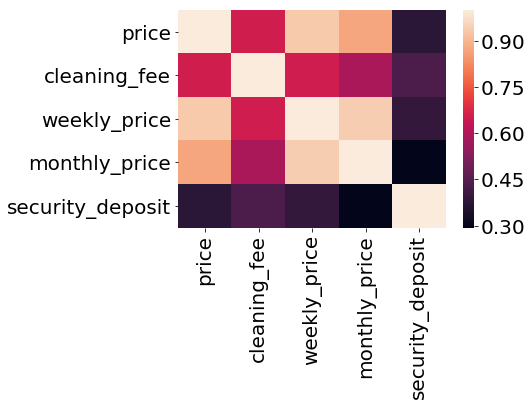

In [126]:
sns.heatmap(corr)

C:\Anaconda3\envs\py36\lib\site-packages\numpy\core\fromnumeric.py:2223: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


(20, 2)
(20, 2)
(20, 2)
(20, 2)
(20, 2)
(20, 2)
(20, 2)
(20, 2)
(20, 2)
(20, 2)


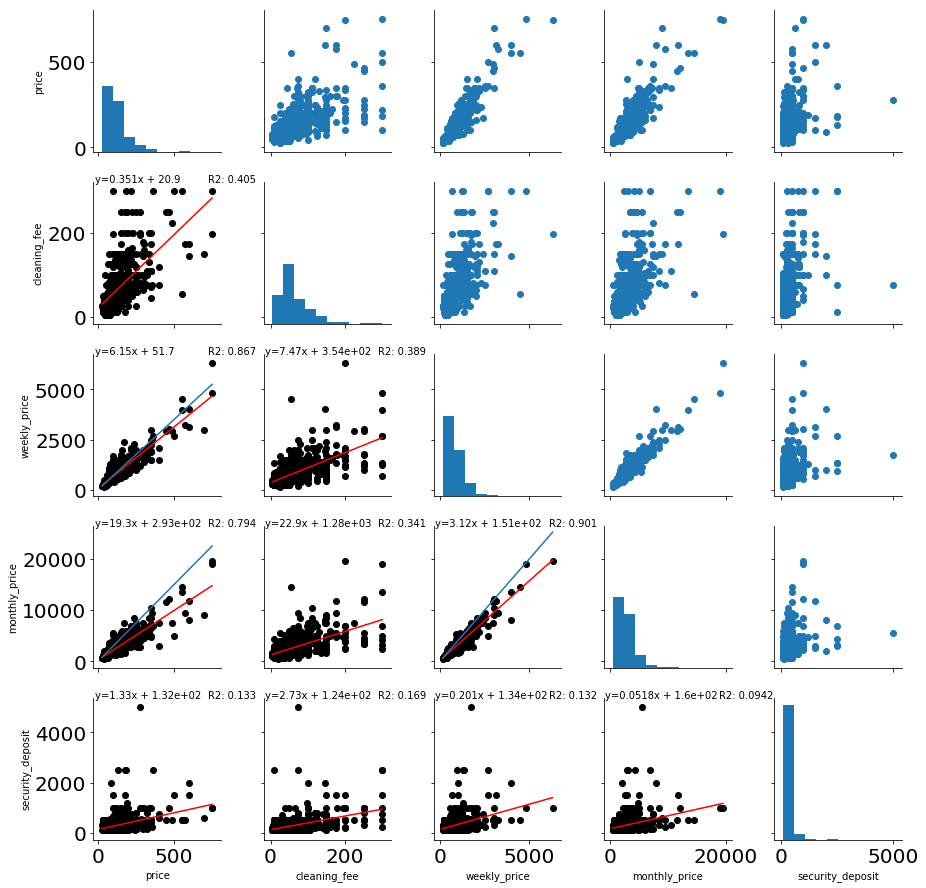

In [127]:
def regplot(x, y, label, color, **kwargs):
    plt.scatter(x, y, c='k')
    name = x.name

    x_reg = pd.Series(data= np.linspace(np.min(x),np.max(x), num=20), name=x.name)
    
    x_reg = sm.add_constant(x_reg)
    print(x_reg.shape)
    x = sm.add_constant(x)    
    mod = sm.OLS(y, x, has_constant ='add')
    res = mod.fit()
#     print(res.summary())
#     print(x_reg, res.predict(x_reg))
    
    plt.plot(x_reg[name], res.predict(x_reg), 'r')
    plt.annotate("R2: {:.3}".format(res.rsquared), xy=(0.9, 1), xycoords='axes fraction')
    plt.annotate("y={:.3}x + {:.3}".format(res.params[name], res.params['const']), xy=(0.01, 1), xycoords='axes fraction')
    if name == 'price':
        if y.name == 'weekly_price':
            plt.plot(x_reg[name], 7*x_reg[name], label='7xprice')
        if y.name == 'monthly_price':
            plt.plot(x_reg[name], 30*x_reg[name], label='30xprice')
        
    if name == 'weekly_price' and y.name=='monthly_price':
        plt.plot(x_reg[name], 4*x_reg[name], label='4xweekly price')
        
    plt.legend()
    return res
    
    


g = sns.PairGrid(data=df_seattle_list_reduced.dropna(axis=0, how='any', subset=price_cols)[price_cols])
g.map_upper(plt.scatter)
g.map_diag(plt.hist)
g.map_lower(regplot)



From the above plot it shows a fairly consistent relationship between the daily, weekly and monthly prices. However, it is interesting to see that in all cases, and especially for the monthly price, some houses and appartments takes a premium to rent for a fixed period. It would often be the customer who gets a premium for fixing a given length, or longer time. 

The lower half of the matrix shows the scatter data with overlay of the linear regression line fitted to the data in blue, and a multiple of the x-axis (7xprice = weekly price, 30xprice = monthly price and 4xweekly price = monthly price). This is where we can see that although the average trend in lower price for a longer fixation of the rental, some appartments operate with higher prices. 

We also see that cleaning fees are not possible to correlate with the price of the appartment. They may have a slight trend, but the distribution is wide for all prices for the appartment. However, it can look like people are using round numbers. 


Anyway, we will use the found relationships to impute values for the appartments. 

In [128]:
def impute_prices(df, basis_col='price', impute_to=['weekly_price', 'monthly_price']):
    #Build models based on existing values
    for col in impute_to:
        x = sm.add_constant(df.dropna(axis=0, how='any', subset=[basis_col,col])[basis_col])
        y = df.dropna(axis=0, how='any', subset=[basis_col,col])[col]
#         print(x, y)
        model = sm.OLS(y,x).fit()
#         print(model.summary())
        preds = model.predict(sm.add_constant(df[basis_col]))
#         print(preds)
        df.loc[df[col].isnull(),col] = preds[df[col].isnull()]
    return df
        
df_seattle_cleaned = impute_prices(df_seattle_list_reduced.copy())
df_seattle_cleaned = df_seattle_cleaned.drop(['cleaning_fee','security_deposit'], axis=1)

However, some of these columns and the missing data and what to do with it will depend on what we are trying to find out. So, lets go looking for some questions about the data. 


One interesting question is related to the pricing of weekly and monthly prices. Is there something about the appartments or hosts that takes a premium on the weekly prices? Is there something interesting about the rental for those appartments or houses, do they have more days a year rental?

(20, 2)


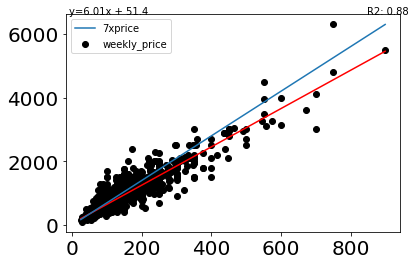

In [129]:
x= df_seattle_list_reduced.dropna(axis=0, how='any', subset=['weekly_price'])['price']
y= df_seattle_list_reduced.dropna(axis=0, how='any', subset=['weekly_price'])['weekly_price']
week_res = regplot(x, y, 'fe', 'efw')

In [130]:
week_res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:           weekly_price   R-squared:                       0.880
Model:                            OLS   Adj. R-squared:                  0.880
Method:                 Least Squares   F-statistic:                 1.466e+04
Date:                Tue, 21 May 2019   Prob (F-statistic):               0.00
Time:                        23:32:19   Log-Likelihood:                -13335.
No. Observations:                2009   AIC:                         2.667e+04
Df Residuals:                    2007   BIC:                         2.669e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         51.3574      7.352      6.985      0.000      36.938      65.777
price          6.0079      0.050    121.079      0.000       5.911       6.105
==============================================================================
Omnibus:                      686.226   Durbin-Watson:                   1.989
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            11995.980
Skew:                           1.142   Prob(JB):                         0.00
Kurtosis:                      14.751   Cond. No.                         264.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Text(0.2, 0.9741164758586361, '2.6% of appartments\n charge 40% margin or more')

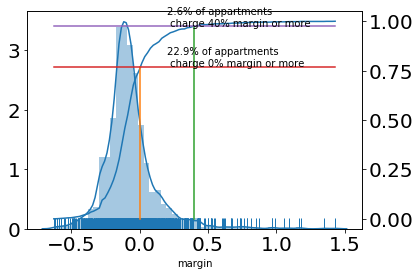

In [131]:
#df_weekly_premium = df_seattle_list_reduced[df_seattle_list_reduced['weekly_price']>res.predict(sm.add_constant(df_seattle_list_reduced['price']))]
weekly_premium = pd.DataFrame({'weekly_price':df_seattle_list_reduced['weekly_price'], 
              'regression_weekly_price': week_res.predict(sm.add_constant(df_seattle_list_reduced['price'])), 
              '7x line' : df_seattle_list_reduced['price']*7,
              'margin' : (df_seattle_list_reduced['weekly_price']/(df_seattle_list_reduced['price']*7))-1,
              'premium?': df_seattle_list_reduced['weekly_price']>week_res.predict(sm.add_constant(df_seattle_list_reduced['price']))})

ax = sns.distplot(weekly_premium['margin'].dropna(), bins=50, rug=True)
cdf = sm.distributions.ECDF(weekly_premium['margin'].dropna())
ax2 = plt.twinx(ax)
x_cdf = np.linspace(min(weekly_premium['margin'].dropna()), max(weekly_premium['margin'].dropna()),100)
ax2.plot(x_cdf, cdf(x_cdf))
weekly_premium.describe()

ax2.plot((0,0),(0,cdf(0)))
ax2.plot((0.4,0.4),(0,cdf(0.4)))
ax2.plot((min(x_cdf),max(x_cdf)),(cdf(0),cdf(0)))
ax2.plot((min(x_cdf),max(x_cdf)),(cdf(0.4),cdf(0.4)))
ax2.annotate('{:.1f}% of appartments\n charge {}% margin or more'.format((1-cdf(0))*100,0), (.2, cdf(0)))
ax2.annotate('{:.1f}% of appartments\n charge {}% margin or more'.format((1-cdf(0.4))*100,40), (.2, cdf(0.4)))


As can be seen from the distribution plot above, we found the weekly price compared to a 7x daily price and found the margin for each of them and plotting the distribution of the margin. In addition, the cummulative distribution is plotted at the right y-axis to give insight on what % of flats are lower than a certain margin. 


We see that 22.9% of the appartments with a given weekly price charge a premium on their appratment to book for a full week compared to the daily given price. A mere 2.6% is charging more than 40% premium on their listing. 

So who are they? 

Well, lets look at the monthly prices first compared to the daily price and a 30 day average month. 

(20, 2)


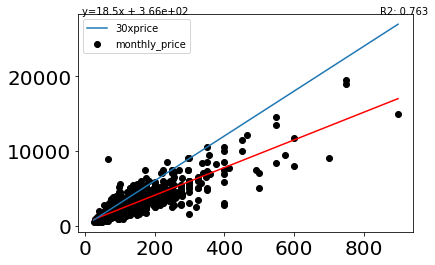

In [132]:
x= df_seattle_list_reduced.dropna(axis=0, how='any', subset=['monthly_price'])['price']
y= df_seattle_list_reduced.dropna(axis=0, how='any', subset=['monthly_price'])['monthly_price']
res = regplot(x, y, 'fe', 'efw')

In [133]:
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          monthly_price   R-squared:                       0.763
Model:                            OLS   Adj. R-squared:                  0.763
Method:                 Least Squares   F-statistic:                     4875.
Date:                Tue, 21 May 2019   Prob (F-statistic):               0.00
Time:                        23:32:20   Log-Likelihood:                -12364.
No. Observations:                1517   AIC:                         2.473e+04
Df Residuals:                    1515   BIC:                         2.474e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        365.5950     38.733      9.439      0.000     289.619     441.571
price         18.5110      0.265     69.822      0.000      17.991      19.031
==============================================================================
Omnibus:                      425.015   Durbin-Watson:                   1.939
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             7775.017
Skew:                           0.824   Prob(JB):                         0.00
Kurtosis:                      13.968   Cond. No.                         263.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Text(0.2, 0.9241924851680949, '7.6% of appartments\n charge 0% margin or more')

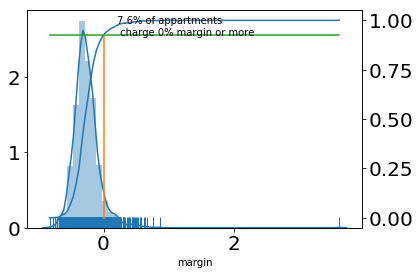

In [134]:
weekly_premium = pd.DataFrame({'monthly_price':df_seattle_list_reduced['monthly_price'], 
              'estimate': res.predict(sm.add_constant(df_seattle_list_reduced['price'])), 
              '30x line' : df_seattle_list_reduced['price']*30,
              'margin' : (df_seattle_list_reduced['monthly_price']/(df_seattle_list_reduced['price']*30))-1,
              'premium?': df_seattle_list_reduced['monthly_price']>res.predict(sm.add_constant(df_seattle_list_reduced['price']))})

ax = sns.distplot(weekly_premium['margin'].dropna(), bins=50, rug=True)
cdf = sm.distributions.ECDF(weekly_premium['margin'].dropna())
ax2 = plt.twinx(ax)
x_cdf = np.linspace(min(weekly_premium['margin'].dropna()), max(weekly_premium['margin'].dropna()),100)
ax2.plot(x_cdf, cdf(x_cdf))
weekly_premium.describe()

ax2.plot((0,0),(0,cdf(0)))
ax2.plot((min(x_cdf),max(x_cdf)),(cdf(0),cdf(0)))
ax2.annotate('{:.1f}% of appartments\n charge {}% margin or more'.format((1-cdf(0))*100,0), (.2, cdf(0)))


So, apparently, the amount of appartments charging a premium for monthly bookings are much less. However, lets start with the weekly and see if we can find out something about them. 

One hypothesis is that the appartments charging a weekly premium is very popular, high ratings, central etc. 

Another is that the host are professional and have multiple listings.

Also, it will be interesting to see if there is a certain trade mark for the listings offering a weekly or monthly price vs the once that does not! 

In [135]:
df_seattle_list['last_scraped'].unique()

array(['2016-01-04'], dtype=object)

In [136]:
df = df_seattle_list_reduced.dropna(subset=['weekly_price'])

C:\Anaconda3\envs\py36\lib\site-packages\numpy\core\_methods.py:140: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims)
C:\Anaconda3\envs\py36\lib\site-packages\numpy\core\_methods.py:132: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Anaconda3\envs\py36\lib\site-packages\statsmodels\nonparametric\bandwidths.py:20: RuntimeWarning: invalid value encountered in minimum
  return np.minimum(np.std(X, axis=0, ddof=1), IQR)
C:\Anaconda3\envs\py36\lib\site-packages\numpy\core\fromnumeric.py:83: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Anaconda3\envs\py36\lib\site-packages\seaborn\distributions.py:198: RuntimeWarning: Mean of empty slice.
  line, = ax.plot(a.mean(), 0)
C:\Anaconda3\envs\py36\lib\site-packages\numpy\core\_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
C:\Anaconda3\envs\

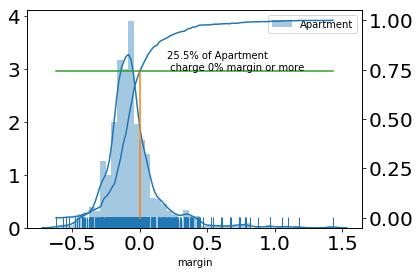

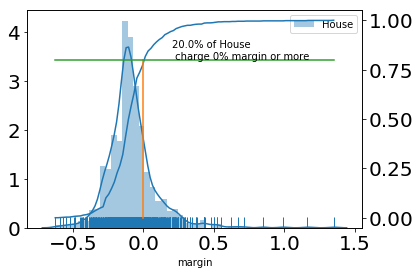

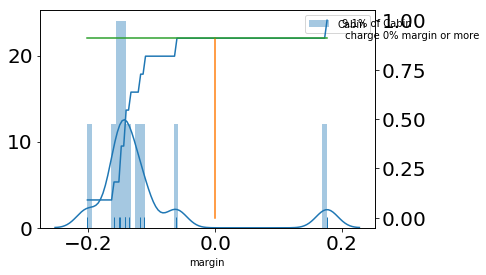

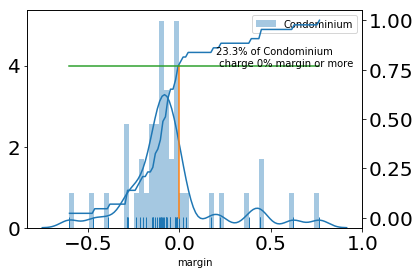

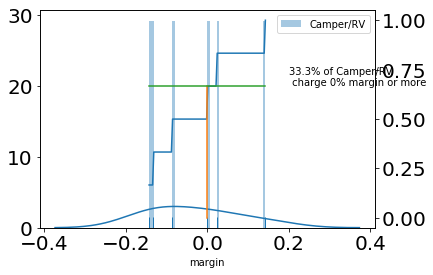

...

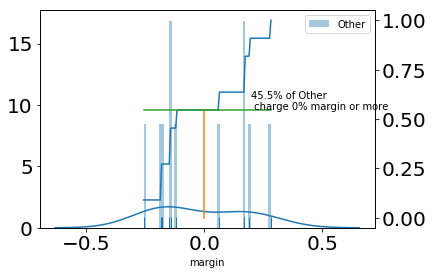

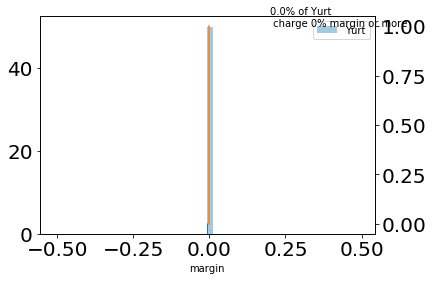

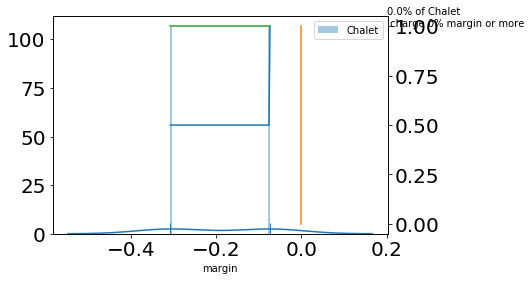

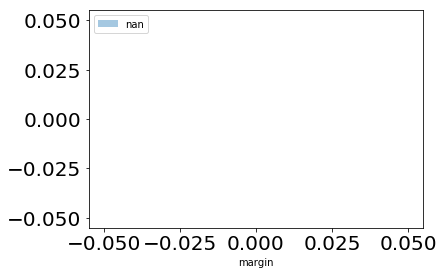

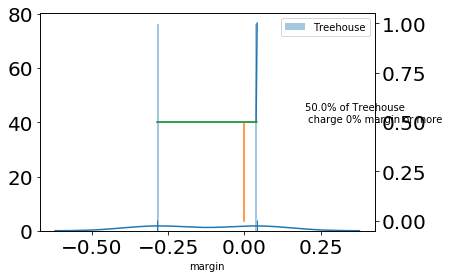

In [137]:
weekly_premium = pd.DataFrame({'regression_weekly_price': week_res.predict(sm.add_constant(df_seattle_list_reduced['price'])), 
              '7x line' : df_seattle_list_reduced['price']*7,
              'margin' : (df_seattle_list_reduced['weekly_price']/(df_seattle_list_reduced['price']*7))-1,
              'premium': df_seattle_list_reduced['weekly_price']>week_res.predict(sm.add_constant(df_seattle_list_reduced['price']))})
df_weekly = pd.concat([df_seattle_list_reduced, weekly_premium], axis=1)
df_weekly
df_weekly_drop = df_weekly.dropna(axis=0, how='any', subset=['weekly_price'])
df_weekly_drop
for ptype in df_weekly_drop['property_type'].unique():
#     print(df_weekly_drop['property_type'] == ptype)
    try:
        fig, ax = plt.subplots(1,1)
        sns.distplot(df_weekly_drop[df_weekly_drop['property_type'] == ptype]['margin'], bins=50, rug=True, ax = ax, label=ptype)
        ax.legend()
        cdf = sm.distributions.ECDF(df_weekly_drop[df_weekly_drop['property_type'] == ptype]['margin'])
        ax2 = plt.twinx(ax)
        xmin = min(df_weekly_drop[df_weekly_drop['property_type'] == ptype]['margin'])
        xmax = max(df_weekly_drop[df_weekly_drop['property_type'] == ptype]['margin'])
        x_cdf = np.linspace(xmin, xmax,100)
        ax2.plot(x_cdf, cdf(x_cdf))
        ax2.plot((0,0),(0,cdf(0)))
        ax2.plot((min(x_cdf),max(x_cdf)),(cdf(0),cdf(0)))
        ax2.annotate('{:.1f}% of {}\n charge {}% margin or more'.format((1-cdf(0))*100,ptype,0),  (.2, cdf(0)))
    except ZeroDivisionError:
        continue
        

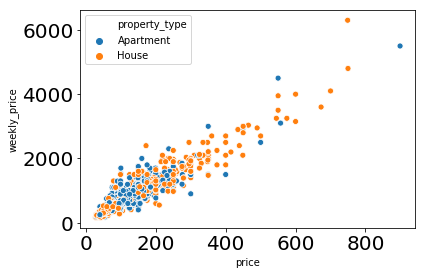

In [138]:
sns.scatterplot(x='price', y='weekly_price', hue='property_type', data=df_weekly_drop[df_weekly_drop['property_type'].isin(['Apartment', 'House'])])

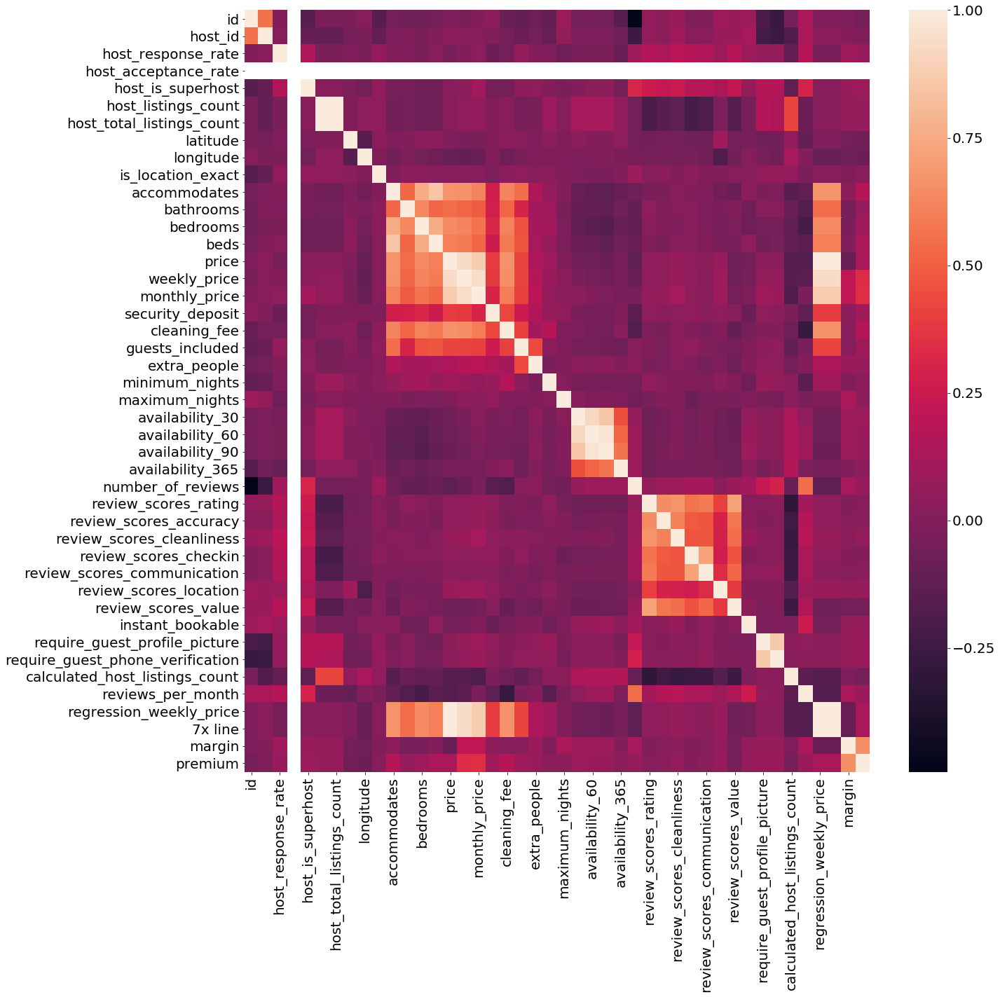

In [139]:
corr = df_weekly_drop.corr()
# print(corr.premium.sort_values())
fig, ax = plt.subplots(1,1, figsize=(20,20))
sns.heatmap(corr)


id  host_id  host_since  host_response_time  \
property_type room_type                                                        
Apartment     Entire home/apt  1428     1428        1426                1247   
              Private room      229      229         229                 184   
              Shared room        51       51          51                  43   
House         Entire home/apt   894      894         894                 766   
              Private room      784      784         784                 674   
              Shared room        55       55          55                  54   
Townhouse     Entire home/apt    54       54          54                  47   
              Private room       62       62          62                  53   
              Shared room         2        2           2                   2   

                               host_response_rate  host_acceptance_rate  \
property_type room_type                                                   
Apartment     Entire home/apt                1247                  1174   
              Private room                    184                   164   
              Shared room                      43                    42   
House         Entire home/apt                 766                   696   
              Private room                    674                   621   
              Shared room                      54                    54   
Townhouse     Entire home/apt                  47                    41   
              Private room                     53                    48   
              Shared room                       2                     2   

                               host_is_superhost  host_listings_count  \
property_type room_type                                                 
Apartment     Entire home/apt               1426                 1426   
              Private room                   229                  229   
              Shared room                     51                   51   
House         Entire home/apt                894                  894   
              Private room                   784                  784   
              Shared room                     55                   55   
Townhouse     Entire home/apt                 54                   54   
              Private room                    62                   62   
              Shared room                      2                    2   

                               host_total_listings_count  host_verifications  \
property_type room_type                                                        
Apartment     Entire home/apt                       1426                1428   
              Private room                           229                 229   
              Shared room                             51                  51   
House         Entire home/apt                        894                 894   
              Private room                           784                 784   
              Shared room                             55                  55   
Townhouse     Entire home/apt                         54                  54   
              Private room                            62                  62   
              Shared room                              2                   2   

                               host_identity_verified  neighbourhood  \
property_type room_type                                                
Apartment     Entire home/apt                    1426           1276   
              Private room                        229            195   
              Shared room                          51             41   
House         Entire home/apt                     894            813   
              Private room                        784            694   
              Shared room                          55             49   
Townhouse     Entire home/apt                      54            

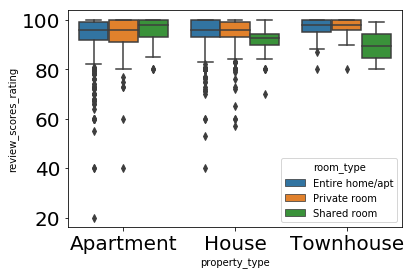

In [140]:
data = df_seattle_list_reduced[df_seattle_list_reduced['property_type'].isin(['Apartment', 'House', 'Townhouse'])]

sns.boxplot(x='property_type', y='review_scores_rating', hue='room_type', data=data)


df_seattle_list_reduced[df_seattle_list_reduced['property_type'].isin(['Apartment', 'House', 'Townhouse'])].groupby(by=['property_type', 'room_type']).count()


In [141]:
df_seattle_list_reduced[df_seattle_list_reduced['property_type'].isin(['Apartment', 'House', 'Townhouse'])].groupby(by=['property_type', 'room_type']).median()[['number_of_reviews','review_scores_rating']]

number_of_reviews  review_scores_rating
property_type room_type                                               
Apartment     Entire home/apt                9.0                  96.0
              Private room                   8.0                  96.0
              Shared room                    4.0                  98.0
House         Entire home/apt                7.0                  96.0
              Private room                  14.0                  96.0
              Shared room                    4.0                  92.5
Townhouse     Entire home/apt                3.0                  98.0
              Private room                   3.5                  98.0
              Shared room                    9.5                  89.5

In [142]:
df_seattle_list_reduced[df_seattle_list_reduced['property_type'].isin(['Apartment', 'House', 'Townhouse'])].groupby(by=['property_type', 'room_type']).mean()[['number_of_reviews','review_scores_rating']]


number_of_reviews  review_scores_rating
property_type room_type                                               
Apartment     Entire home/apt          21.211485             93.984140
              Private room             22.567686             93.638743
              Shared room              15.176471             95.435897
House         Entire home/apt          20.300895             94.927536
              Private room             27.747449             94.954338
              Shared room              10.763636             91.409091
Townhouse     Entire home/apt           9.074074             96.342857
              Private room              9.838710             97.186047
              Shared room               9.500000             89.500000

In [143]:
df_seattle_list_reduced[df_seattle_list_reduced['property_type'].isin(['Apartment', 'House', 'Townhouse'])].groupby(by=['property_type', 'room_type']).count()[['number_of_reviews','review_scores_rating']]

number_of_reviews  review_scores_rating
property_type room_type                                               
Apartment     Entire home/apt               1428                  1198
              Private room                   229                   191
              Shared room                     51                    39
House         Entire home/apt                894                   759
              Private room                   784                   657
              Shared room                     55                    44
Townhouse     Entire home/apt                 54                    35
              Private room                    62                    43
              Shared room                      2                     2

In [155]:
#calculate mean yearly price for each listing
df_seattle_cal['price'] = df_seattle_cal['price'].apply(currency_to_number)
df_seattle_cal['available'] = df_seattle_cal['available'].apply(boolean_to_int)
mean_yearly_vals = df_seattle_cal.groupby('listing_id').median()
mean_yearly_vals.rename(columns={'price' : 'mean yearly price'},  inplace=True)
mean_yearly_vals

,available,mean yearly price
listing_id,,
3335,1,120.0
4291,1,82.0
5682,1,53.0
6606,1,90.0
7369,0,85.0
9419,1,90.0
9460,0,109.0
9531,0,165.0
9534,1,125.0


In [156]:
df_seattle_list_reduced = pd.concat([df_seattle_list_reduced.sort_values('id').set_index('id'), mean_yearly_vals], axis=1).reset_index()


KeyError: 'id'

In [ ]:
df_seattle_list_reduced['pricePerBed'] = df_seattle_list_reduced['price']/df_seattle_list_reduced['beds']
df_seattle_list_reduced['monthlyPricePerBed'] = df_seattle_list_reduced['monthly_price']/df_seattle_list_reduced['beds']
df_seattle_list_reduced['weeklyPricePerBed'] = df_seattle_list_reduced['weekly_price']/df_seattle_list_reduced['beds']
df_seattle_list_reduced['margin'] = (df_seattle_list_reduced['weekly_price']/(df_seattle_list_reduced['mean yearly price']*7))-1

In [151]:
df_seattle_list_reduced.columns

Index(['index', 'host_id', 'host_since', 'host_response_time',
       'host_response_rate', 'host_acceptance_rate', 'host_is_superhost',
       'host_listings_count', 'host_total_listings_count',
       'host_verifications', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'zipcode',
       'latitude', 'longitude', 'is_location_exact', 'property_type',
       'room_type', 'accommodates', 'bathrooms', 'bedrooms', 'beds',
       'bed_type', 'amenities', 'price', 'weekly_price', 'monthly_price',
       'security_deposit', 'cleaning_fee', 'guests_included', 'extra_people',
       'minimum_nights', 'maximum_nights', 'calendar_updated',
       'availability_30', 'availability_60', 'availability_90',
       'availability_365', 'number_of_reviews', 'first_review', 'last_review',
       'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 're

In [157]:
mean_neighborhood = df_seattle_list_reduced.groupby('neighbourhood_group_cleansed').mean().reset_index()
mean_neighborhood


,neighbourhood_group_cleansed,index,host_id,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,beds,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,pricePerBed,monthlyPricePerBed,weeklyPricePerBed,available,mean yearly price,margin
0,Ballard,5.180190e+06,1.498283e+07,0.951765,1.000000,0.265217,5.004348,5.004348,47.674525,-122.380150,0.900000,3.443478,1.289130,1.434783,1.847826,124.682609,802.248000,2622.666667,292.731481,65.376623,1.865217,9.256522,2.208696,758.334783,15.660870,34.256522,54.769565,252.673913,30.947826,95.533679,9.730570,9.668394,9.901554,9.927461,9.766839,9.569948,0.169565,0.047826,0.069565,1.656522,2.570725,73.265704,1677.280372,463.951905,0.692257,126.857885,-0.110964
1,Beacon Hill,5.052427e+06,1.502024e+07,0.959810,1.000000,0.152542,2.822034,2.822034,47.569667,-122.306754,0.847458,2.991525,1.230769,1.262712,1.627119,94.669492,649.160000,2414.976744,242.413793,47.560000,1.440678,10.584746,2.016949,670.500000,17.796610,38.661017,61.220339,256.525424,28.432203,94.019417,9.592233,9.466019,9.834951,9.825243,9.097087,9.359223,0.144068,0.169492,0.169492,2.720339,2.432233,64.068321,1522.468992,426.364762,0.702809,97.705748,-0.118919
2,Capitol Hill,5.668931e+06,1.698144e+07,0.953516,0.997748,0.149912,4.795414,4.795414,47.623578,-122.316462,0.888889,2.989418,1.265957,1.139823,1.532628,130.592593,825.551095,2823.843931,292.888430,54.526718,1.537919,8.917108,3.867725,775.453263,16.012346,35.021164,54.888889,233.982363,21.890653,94.184783,9.572052,9.424837,9.777293,9.802174,9.823529,9.348584,0.153439,0.047619,0.059965,3.649030,2.010974,91.282321,1902.978530,586.859764,0.641048,135.077805,-0.106346
3,Cascade,6.089536e+06,1.703599e+07,0.890303,1.000000,0.179775,3.483146,3.483146,47.633757,-122.331631,0.887640,2.921348,1.151685,1.101124,1.415730,140.101124,925.740000,3151.605263,428.488372,48.890625,1.516854,10.561798,2.449438,836.325843,13.247191,30.280899,49.325843,210.303371,15.955056,92.461538,9.369231,9.261538,9.815385,9.815385,9.569231,9.215385,0.202247,0.067416,0.067416,1.404494,1.805077,102.086142,2439.166667,703.346667,0.576174,146.140167,-0.094123
4,Central Area,5.587679e+06,1.618958e+07,0.938875,1.000000,0.271003,1.997290,1.997290,47.607715,-122.301760,0.899729,3.509485,1.392954,1.436314,1.815718,128.338753,763.552885,2503.832215,311.390110,59.946429,1.845528,11.701897,2.010840,695.962060,15.693767,35.490515,56.208672,245.409214,22.878049,96.009404,9.761755,9.655172,9.833856,9.852665,9.489028,9.572327,0.124661,0.056911,0.062331,1.815718,2.197188,77.767397,1547.766779,475.713782,0.672354,132.654824,-0.123579
5,Delridge,5.217371e+06,1.635080e+07,0.970154,1.000000,0.240506,1.341772,1.341772,47.545983,-122.362599,0.898734,2.860759,1.120253,1.215190,1.493671,83.278481,585.208333,1869.315789,312.027027,43.916667,1.506329,7.987342,1.924051,656.341772,18.240506,40.797468,64.063291,272.721519,27.810127,95.861538,9.846154,9.738462,9.984615,9.969231,9.200000,9.676923,0.139241,0.088608,0.126582,1.291139,2.182308,61.295359,1228.850877,412.579861,0.747182,87.804785,-0.071622
6,Downtown,5.683918e+06,1.426956e+07,0.942316,1.000000,0.198864,25.354167,25.354167,47.611406,-122.337498,0.854717,3.566038,1.207224,1.062619,1.741509,154.405660,1084.110577,3661.154696,259.557377,74.468966,1.467925,10.950943,2.203774,981.475472,17.928302,39.330189,61.709434,237.216981,23.784906,93.958333,9.567033,9.567033,9.650549,9.736842,9.769737,9.274123,0.205660,0.233962,0.254717,3.752830,2

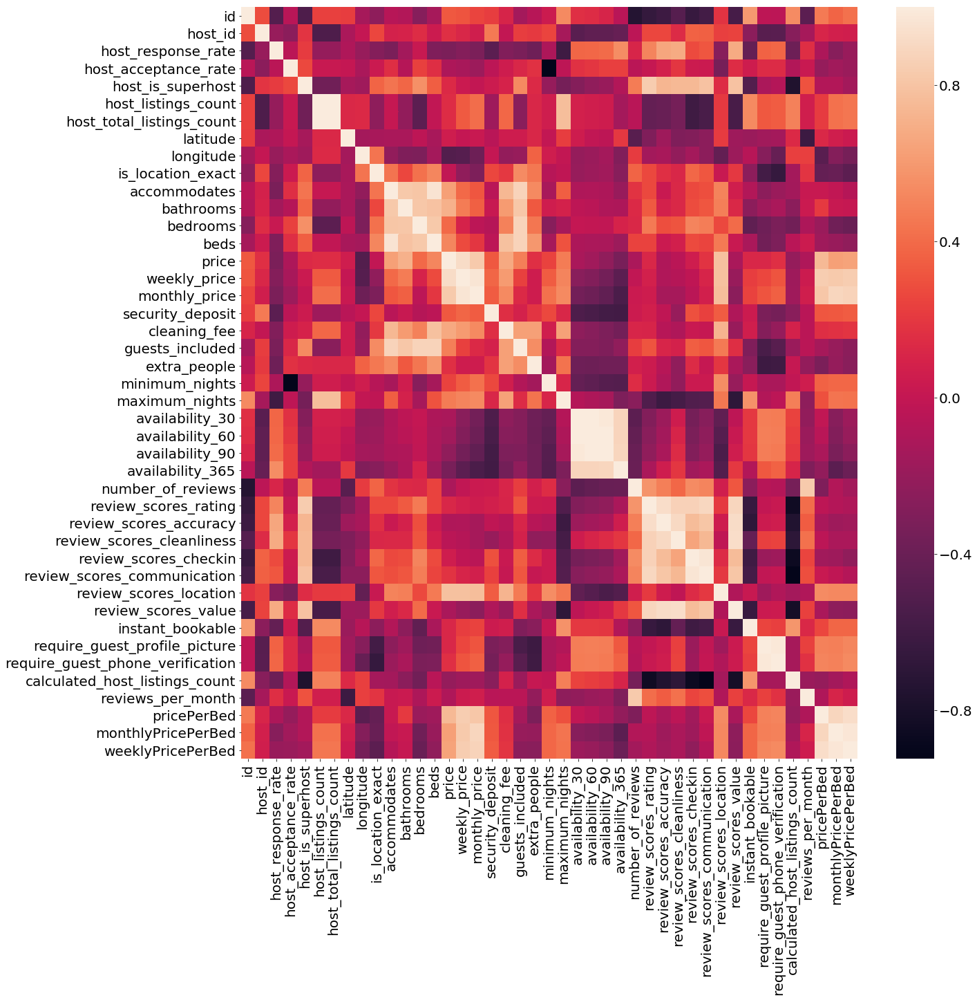

In [49]:
corr = mean_neighborhood.corr()
fig, ax = plt.subplots(1,1, figsize=(20,20))
sns.heatmap(corr, ax = ax)

In [158]:
mean_neighborhood_2 = df_seattle_list_reduced.groupby('neighbourhood').mean().reset_index()
mean_neighborhood_2

,neighbourhood,index,host_id,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,beds,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,pricePerBed,monthlyPricePerBed,weeklyPricePerBed,available,mean yearly price,margin
0,Alki,5.513224e+06,1.568420e+07,0.988421,1.000000,0.130435,2.086957,2.086957,47.571967,-122.408159,1.000000,4.565217,1.391304,1.826087,2.391304,196.652174,1150.133333,3394.090909,276.470588,96.450000,1.608696,15.869565,2.217391,791.956522,20.304348,44.173913,67.521739,250.347826,15.956522,95.933333,9.666667,9.733333,9.866667,9.933333,9.866667,9.466667,0.173913,0.086957,0.086957,1.260870,1.871250,99.764493,1489.393939,500.210000,0.685884,214.998884,-0.026090
1,Arbor Heights,3.961523e+06,9.899291e+06,1.000000,1.000000,0.333333,1.000000,1.000000,47.510145,-122.381473,1.000000,4.000000,1.166667,1.000000,1.666667,118.000000,880.000000,950.000000,275.000000,53.000000,2.000000,11.666667,3.000000,384.333333,18.333333,47.000000,76.666667,260.000000,15.333333,98.000000,9.666667,9.666667,10.000000,10.000000,8.666667,9.333333,0.000000,0.000000,0.333333,1.000000,1.030000,73.555556,950.000000,513.333333,0.712329,122.733132,-0.044120
2,Atlantic,5.267910e+06,1.734774e+07,0.945581,1.000000,0.220000,1.940000,1.940000,47.594896,-122.304818,1.000000,3.700000,1.470000,1.420000,1.780000,116.280000,699.694444,2203.259259,279.318182,52.292683,1.620000,12.180000,1.860000,707.900000,13.860000,32.100000,50.200000,218.920000,22.980000,95.325581,9.627907,9.627907,9.813953,9.767442,9.093023,9.558140,0.220000,0.020000,0.040000,1.660000,2.249545,70.228333,1278.759259,415.384259,0.599781,119.709817,-0.150095
3,Ballard,4.924953e+06,1.432290e+07,0.953613,1.000000,0.267606,5.328638,5.328638,47.674617,-122.379902,0.976526,3.394366,1.274648,1.408451,1.845070,123.615023,800.316667,2603.653333,291.530612,63.041379,1.859155,10.230047,2.286385,732.694836,15.859155,34.403756,55.018779,250.807512,33.380282,95.382514,9.737705,9.666667,9.907104,9.918033,9.759563,9.546448,0.159624,0.056338,0.079812,1.680751,2.613169,73.794970,1670.150476,466.920040,0.687144,125.366038,-0.097151
4,Belltown,5.288179e+06,1.187108e+07,0.938783,1.000000,0.188119,34.089109,34.089109,47.615125,-122.345542,0.906863,3.887255,1.237500,1.118227,1.901961,166.627451,1102.789474,3843.161765,273.500000,85.447514,1.372549,9.995098,2.137255,1265.362745,18.348039,39.882353,62.784314,224.965686,21.235294,93.340659,9.478022,9.543956,9.582418,9.686813,9.807692,9.192308,0.205882,0.338235,0.367647,5.039216,1.948901,101.278711,2824.443627,832.356360,0.616344,194.947064,-0.052264
5,Bitter Lake,4.873412e+06,1.509294e+07,0.955556,1.000000,0.076923,1.769231,1.769231,47.715759,-122.352205,1.000000,3.076923,1.230769,1.153846,1.307692,78.846154,527.500000,1821.285714,286.875000,38.333333,1.615385,10.461538,1.692308,769.692308,16.000000,31.923077,50.307692,233.461538,15.384615,95.666667,9.500000,9.250000,9.833333,9.666667,9.333333,9.583333,0.307692,0.000000,0.000000,1.769231,1.550833,63.461538,1345.285714,368.611111,0.639621,79.301492,-0.091441
6,Brighton,6.612498e+06,2.025348e+07,1.000000,1.000000,0.400000,1.400000,1.400000,47.539153,-122.278180,1.000000,3.000000,0.900000,0.800000,1.600000,78.000000,581.666667,1825.000000,181.666667,31.250000,1.600000,7.000000,1.400000,462.200000,26.800000,56.800000,86.600000,269.400000,28.000000,94.500000,10.000000,10.000000,10.000000,10.000000,9.000000,9.750000,0.200000,0.000000,0.000000,1.400000,3.770000,49.50

In [159]:
mean_nea = df_seattle_list_reduced.groupby('neighbourhood_cleansed').mean().reset_index()
mean_nea

,neighbourhood_cleansed,index,host_id,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,latitude,longitude,is_location_exact,accommodates,bathrooms,bedrooms,beds,price,weekly_price,monthly_price,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,instant_bookable,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,reviews_per_month,pricePerBed,monthlyPricePerBed,weeklyPricePerBed,available,mean yearly price,margin
0,Adams,5.128735e+06,1.732395e+07,0.953333,1.000000,0.314286,2.014286,2.014286,47.671506,-122.386485,0.900000,3.400000,1.328571,1.414286,1.871429,121.671429,861.810811,3224.000000,288.235294,72.306122,1.685714,9.857143,2.142857,811.528571,16.571429,35.514286,55.228571,224.900000,27.828571,95.350877,9.666667,9.719298,9.912281,9.964912,9.877193,9.508772,0.200000,0.028571,0.042857,1.671429,2.550702,74.984932,1856.045031,490.884813,0.616164,125.504949,-0.077141
1,Alki,6.152711e+06,1.674001e+07,0.968378,1.000000,0.119048,2.738095,2.738095,47.575052,-122.408047,0.738095,4.095238,1.321429,1.714286,2.119048,171.619048,971.875000,3185.166667,250.000000,88.571429,1.523810,14.238095,2.690476,798.880952,20.714286,44.547619,69.261905,267.976190,13.119048,95.892857,9.678571,9.750000,9.892857,9.857143,9.892857,9.500000,0.142857,0.071429,0.071429,1.952381,1.736552,91.863095,1584.638889,501.735417,0.734181,187.794611,-0.129045
2,Arbor Heights,5.922527e+06,1.363502e+07,0.800000,1.000000,0.200000,1.000000,1.000000,47.510429,-122.381931,0.600000,3.800000,1.300000,1.400000,2.000000,126.800000,880.000000,950.000000,275.000000,58.500000,1.600000,7.000000,2.200000,680.600000,17.000000,40.200000,64.000000,278.000000,9.200000,98.000000,9.666667,9.666667,10.000000,10.000000,8.666667,9.333333,0.000000,0.000000,0.200000,1.000000,1.030000,66.383333,950.000000,513.333333,0.761644,129.639879,-0.044120
3,Atlantic,5.681475e+06,1.844724e+07,0.932381,1.000000,0.207547,1.886792,1.886792,47.595164,-122.305620,0.943396,3.320755,1.377358,1.264151,1.716981,111.396226,714.270270,2240.296296,275.826087,51.634146,1.509434,11.773585,1.830189,689.452830,13.716981,33.037736,53.094340,222.396226,22.000000,95.333333,9.690476,9.666667,9.809524,9.738095,9.095238,9.571429,0.226415,0.018868,0.037736,1.622642,2.280698,69.216981,1294.808642,419.009009,0.609305,114.110759,-0.142675
4,Belltown,5.521046e+06,1.230983e+07,0.935142,1.000000,0.181034,32.926724,32.926724,47.615147,-122.345487,0.850427,3.803419,1.223913,1.098712,1.850427,162.893162,1097.402439,3789.797297,263.510204,84.092233,1.363248,9.846154,2.141026,1216.320513,18.064103,39.512821,62.371795,227.863248,20.025641,93.477833,9.477833,9.561576,9.581281,9.694581,9.817734,9.197044,0.192308,0.320513,0.346154,4.987179,1.986108,102.128307,2784.308559,826.635163,0.624283,190.391763,-0.050717
5,Bitter Lake,5.977676e+06,1.614098e+07,0.936364,1.000000,0.076923,1.692308,1.692308,47.715528,-122.352218,0.923077,3.153846,1.230769,1.230769,1.384615,83.000000,600.428571,2131.125000,370.714286,76.250000,1.615385,8.307692,1.538462,914.461538,20.384615,40.923077,63.230769,233.846154,10.307692,94.916667,9.666667,9.083333,9.750000,9.750000,9.500000,9.500000,0.230769,0.000000,0.000000,1.615385,1.619167,62.038462,1528.687500,394.821429,0.640674,85.482726,-0.126091
6,Briarcliff,5.355968e+06,1.953634e+07,0.948462,1.000000,0.214286,2.714286,2.714286,47.646219,-122.407149,1.000000,5.928571,1.678571,2.000000,2.928571,176.571429,1103.166667,3575.000000,407.000000,85.357143,2.285714,15.714286,1.857143,965.500000,25.000000,48.857143,73.571429,315.857143,12.785714,92.750000,9.500000,9.416667,9.750000,9.833333,9.750000,9.166667,0.142857,0.142857,0.142857,1.714286,1.112500,74

In [53]:

def _inline_map(m, width=650, height=500):
    from IPython.display import HTML, display
    srcdoc = m.HTML.replace('"', '&quot;')
    embed = HTML('<iframe srcdoc="{}" '
                'style="width :{}px; height: {}px; display:block; width: 50%; margin: 0 auto;' 
                 'border: none"></iframe>'.format(srcdoc, width, height))
    return embed


def plot_map(df, loc, data_col, prefix=None):
    neighborhoods_json = os.path.join("seattle_neighborhoods.geojson")
    m = folium.Map(location=[47.611406, -122.337498], zoom_start=12)
    
    if loc == 'neighbourhood' or loc == 'neighbourhood_cleansed':
        keyon = 'feature.properties.name'
    elif loc == 'neighbourhood_group_cleansed':
        keyon = 'feature.properties.nhood'
        
    else:
        return None
        
    folium.Choropleth(
        geo_data=neighborhoods_json,
        name='choropleth',
        data=df,
        columns=[loc, data_col],
        key_on=keyon,
        fill_color='YlGnBu',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name= data_col
    ).add_to(m)
    folium.LayerControl().add_to(m)
    if prefix:
        m.save('{}_{}.html'.format(prefix, data_col))
    else:
        m.save('{}.html'.format(data_col))
    return m

In [53]:
for col in mean_neighborhood.drop('neighbourhood_group_cleansed', axis=1):
    plot_map(mean_neighborhood, 'neighbourhood_group_cleansed', col, 'NGroup')
    

In [54]:
for col in mean_neighborhood_2.drop('neighbourhood', axis=1):
    plot_map(mean_neighborhood_2, 'neighbourhood', col, 'nhood')

In [160]:
for col in mean_nea[['margin', 'neighbourhood_cleansed']].drop('neighbourhood_cleansed', axis=1):
    plot_map(mean_nea, 'neighbourhood_cleansed', col, 'nhood_clean')

In [56]:
mean_neighborhood_3 = df_weekly_drop.groupby('neighbourhood_group_cleansed').mean().reset_index()

In [60]:
#m = plot_map(mean_neighborhood_3, 'neighbourhood_group_cleansed', 'premium', 'Ngroup')
mdsa = folium.Map(location=[47.611406, -122.337498], zoom_start=12)

In [61]:
count_neighborhood = df_seattle_list_reduced.groupby('neighbourhood_group_cleansed').count().reset_index()
plot_map(count_neighborhood, 'neighbourhood_group_cleansed', 'id', 'Ngroup_count')

In [62]:
count_neighborhood = df_seattle_list_reduced.groupby('neighbourhood').count().reset_index()
plot_map(count_neighborhood, 'neighbourhood', 'id', 'Nhood_count')

In [63]:
df_corr_check = df_seattle_list_reduced[['host_response_time',
       'host_response_rate', 'host_acceptance_rate', 'host_is_superhost',
       'host_listings_count', 'host_total_listings_count', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 
       'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'beds',
       'bed_type', 'amenities', 'price', 'weekly_price', 'monthly_price',
       'guests_included', 'extra_people',
       'minimum_nights', 'maximum_nights', 'calendar_updated',
       'availability_30', 'availability_60', 'availability_90',
       'availability_365', 'number_of_reviews',
       'review_scores_rating', 'reviews_per_month', 'pricePerBed',
       'monthlyPricePerBed', 'weeklyPricePerBed']]

In [64]:
df_corr_check

,host_response_time,host_response_rate,host_acceptance_rate,host_is_superhost,host_listings_count,host_total_listings_count,neighbourhood,neighbourhood_cleansed,neighbourhood_group_cleansed,latitude,longitude,property_type,room_type,accommodates,beds,bed_type,amenities,price,weekly_price,monthly_price,guests_included,extra_people,minimum_nights,maximum_nights,calendar_updated,availability_30,availability_60,availability_90,availability_365,number_of_reviews,review_scores_rating,reviews_per_month,pricePerBed,monthlyPricePerBed,weeklyPricePerBed
0,within a few hours,0.96,1.0,0.0,3.0,3.0,Queen Anne,West Queen Anne,Queen Anne,47.636289,-122.371025,Apartment,Entire home/apt,4,1.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",85.0,NaN,NaN,2,5.0,1,365,4 weeks ago,14,41,71,346,207,95.0,4.07,85.000000,NaN,NaN
1,within an hour,0.98,1.0,1.0,6.0,6.0,Queen Anne,West Queen Anne,Queen Anne,47.639123,-122.365666,Apartment,Entire home/apt,4,1.0,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",150.0,1000.0,3000.0,1,0.0,2,90,today,13,13,16,291,43,96.0,1.48,150.000000,3000.000000,1000.000000
2,within a few hours,0.67,1.0,0.0,2.0,2.0,Queen Anne,West Queen Anne,Queen Anne,47.629724,-122.369483,House,Entire home/apt,11,7.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",""A...",975.0,NaN,NaN,10,25.0,4,30,5 weeks ago,1,6,17,220,20,97.0,1.15,139.285714,NaN,NaN
3,NaN,NaN,NaN,0.0,1.0,1.0,Queen Anne,West Queen Anne,Queen Anne,47.638473,-122.369279,Apartment,Entire home/apt,3,2.0,Real Bed,"{Internet,""Wireless Internet"",Kitchen,""Indoor ...",100.0,650.0,2300.0,1,0.0,1,1125,6 months ago,0,0,0,143,0,NaN,NaN,50.000000,1150.000000,325.000000
4,within an hour,1.00,NaN,0.0,2.0,2.0,Queen Anne,West Queen Anne,Queen Anne,47.632918,-122.372471,House,Entire home/apt,6,3.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",450.0,NaN,NaN,6,15.0,1,1125,7 weeks ago,30,60,90,365,38,92.0,0.89,150.000000,NaN,NaN
5,NaN,NaN,NaN,0.0,1.0,1.0,Queen Anne,West Queen Anne,Queen Anne,47.630525,-122.366174,House,Private room,2,1.0,Real Bed,"{""Wireless Internet"",""Free Parking on Premises...",120.0,800.0,NaN,1,30.0,1,6,2 weeks ago,0,0,27,302,17,95.0,2.45,120.000000,NaN,800.000000
6,within an hour,1.00,1.0,1.0,1.0,1.0,Queen Anne,West Queen Anne,Queen Anne,47.636605,-122.368519,House,Private room,2,1.0,Real Bed,"{""Wireless Internet"",""Free Parking on Premises...",80.0,575.0,NaN,1,10.0,3,14,5 weeks ago,20,49,71,346,58,99.0,2.46,80.000000,NaN,575.000000
7,within an hour,1.00,1.0,1.0,5.0,5.0,Queen Anne,West Queen Anne,Queen Anne,47.640161,-122.375856,Cabin,Private room,2,1.0,Real Bed,"{""Wireless Internet"",""Pets live on this proper...",60.0,360.0,NaN,1,0.0,2,7,yesterday,22,42,42,100,173,97.0,4.73,60.000000,NaN,360.000000
8,NaN,NaN,1.0,0.0,1.0,1.0,Queen Anne,West Queen Anne,Queen Anne,47.632410,-122.357216,Apartment,Private room,2,1.0,Real Bed,"{TV,""Cable TV"",Internet,""Wireless Internet"",Ki...",90.0,500.0,1700.0,1,0.0,3,1125,5 months ago,6,36,66,341,8,97.0,1.22,90.000000,1700.000000,500.000000
9,within an hour,0.98,1.0,1.0,6.0,6.0,Queen Anne,West Queen Anne,Queen Anne,47.637492,-122.366889,Apartment,Entire home/apt,4,1.0,Real Bed,"{TV,Internet,""Wireless Internet"",Kitchen,""Free...",150.0,1000.0,3000.0,1,0.0,2,365,today,6,19,49,324,32,97.0,1.55,150.000000,3000.000000,1000.000000
